In [1]:
import os
import re
from IPython.display import clear_output
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
# from oneibl.onelight import ONE # only used for downloading data
# import wget
from utils import *
from plotting_utils import *
from analysis_utils import *
import dglm_hmm1
from pandas.errors import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)


ibl_data_path = '../data_IBL'
dfAll = pd.read_csv(ibl_data_path + '/Ibl_processed.csv')
colorsFeatures = [['#FAA61A','indigo','#99CC66','#59C3C3','#9593D9'],['#FAA61A',"#2369BD","#A9373B",'#99CC66','#59C3C3','#9593D9']]
#colorsStates = ['orange','firebrick','forestgreen']#['orange','slateblue','forestgreen'] #['#FAA61A','#59C3C3','#9593D9','#99CC66','indigo'] #['darkorange','darkblue','forestgreen','purple']
colorsStates = ['tab:orange','tab:blue', 'tab:green','tab:red']
myFeatures = [['bias','delta stimulus', 'previous choice', 'previous answer'],['bias','contrast left','contrast right', 'previous choice', 'previous answer']]
sns.set_context("talk")
# colormap = ['rebeccapurple','teal','darkturquoise','springgreen','gold']
# colormap = ['rebeccapurple','royalblue','limegreen','orange']
colormap = ['tab:purple','tab:pink','tab:cyan','yellowgreen']

In [2]:
labChosen =  ['angelakilab','churchlandlab','wittenlab']
subjectsAll = []
for lab in labChosen:
    subjects = np.unique(dfAll[dfAll['lab'] == lab]['subject']).tolist()
    subjectsAll = subjectsAll + subjects

if ('NYU-01' in subjectsAll):
    subjectsAll.remove('NYU-01')
if ('NYU-06' in subjectsAll):
    subjectsAll.remove('NYU-06')
if ('CSHL_007' in subjectsAll):
    subjectsAll.remove('CSHL_007')
if ('CSHL049' in subjectsAll):
    subjectsAll.remove('CSHL049')



In [3]:
# setting hyperparameters
alphaList = [2*(10**x) for x in list(np.arange(-1,6,0.5,dtype=float))] 
L2penaltyW = 1
maxiter = 200
bestSigma = 1 # verified from fitting multiple sigmas
priorDirP = [100,10] # to read dGLMHMM1 model
fit_init_states = False
K = 3
D = 4 # number of features
sessStop = -1 # last session to use in fitting
splitFolds = 5

In [4]:
testLlAll = np.zeros((len(subjectsAll), len(alphaList)+1))
testAccuracyAll = np.zeros((len(subjectsAll), len(alphaList)+1))

for idx in range(0, len(subjectsAll)):
    subject = subjectsAll[idx]
    avgTestLl = []
    avgTestAccuracy = []
    for fold in range(splitFolds):
        data = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}-state_fold-{fold}_multiple-alphas_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
        avgTestLl.append(data['testLl'])
        avgTestAccuracy .append(data['testAccuracy'])
    testLlAll[idx] = np.mean(avgTestLl, axis=0)
    testAccuracyAll[idx] = np.mean(avgTestAccuracy, axis=0)
    
    # fig, axes = plt.subplots(1,figsize=(20,8), dpi=400)
    # fig.suptitle(f'{subject}')
    # for fold in range(0, splitFolds):
    #     plot_testLl_CV_sigma(data['testLl'][fold], sigmaList=sigmaList, label=f'K={K} fold {fold}', color=colormap[K-1], axes=axes)
    
    # avgTestLl = [x - avgTestLl[0][0] for x in avgTestLl] # normalizing to GLM-HMM sigma=0 K=1
    # avgTestAccuracy = [x - avgTestAccuracy[0][0] for x in avgTestAccuracy]


Text(762.4583333333334, 0.5, 'Delta Test Ll (per trial)')

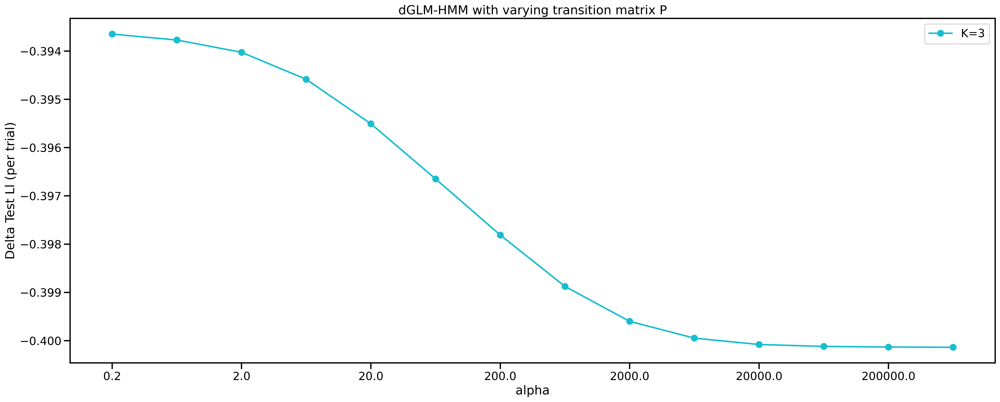

In [5]:
# Plotting testLl per animal or averaged across animals
# for idx in range(0, len(subjectsAll)):
#     fig, axes = plt.subplots(1,figsize=(20,8), dpi=400)
#     fig.tight_layout()
#     subject = subjectsAll[idx]
#     plot_testLl_CV_alpha(testLlAll[idx], alphaList=alphaList, label=f'K={K}', color=colormap[K-1], axes=axes, alpha=1)
fig, axes = plt.subplots(1,figsize=(20,8), dpi=400)
fig.tight_layout()
axes.set_title('averaged across all animals')
plot_testLl_CV_alpha(np.mean(testLlAll, axis=0), alphaList=alphaList, label=f'K={K}', color=colormap[K-1], axes=axes, alpha=1)
axes.set_ylabel("Delta Test Ll (per trial)")

Text(762.4583333333334, 0.5, 'Delta Test Accuracy (per trial)')

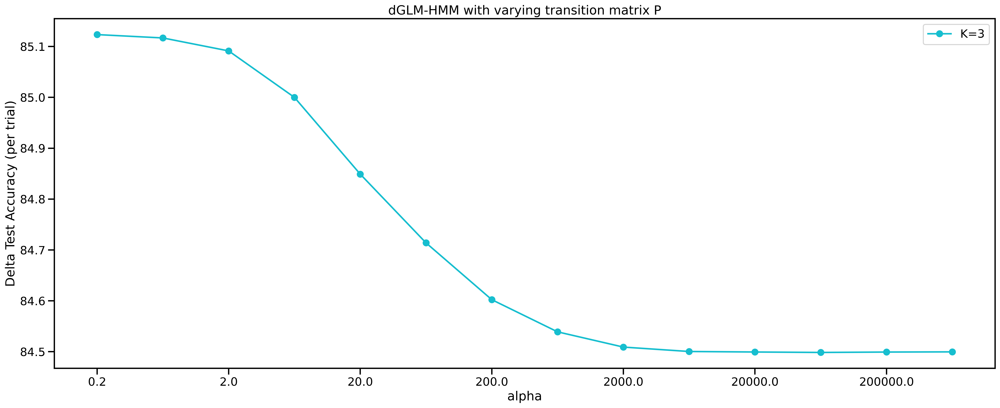

In [58]:
fig, axes = plt.subplots(1,figsize=(20,8), dpi=400)
fig.tight_layout()
axes.set_title('averaged across all animals')
plot_testLl_CV_alpha(np.mean(testAccuracyAll, axis=0), alphaList=alphaList, label=f'K={K}', color=colormap[K-1], axes=axes, alpha=1)
axes.set_ylabel("Delta Test Accuracy (per trial)")

In [7]:
# # Reading parameters and plotting them at best sigma for 
# allW = np.empty((len(subjectsAll)), dtype=object)
# allP = np.empty((len(subjectsAll)), dtype=object)

# alphaInd = 2

# for idx in [0]: #range(0, len(subjectsAll)):
#     subject=subjectsAll[idx]
#     _, _, sessInd, correctSide = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)

#     tempW = []
#     tempP = []
#     for fold in range(splitFolds):
#         data = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}-state_fold-{fold}_multiple-alphas_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
#         tempP.append(data['P'])
#         tempW.append(data['W'])
            
#         # # plotting transition matrix individually 
#         # fig, axes = plt.subplots()
#         # plotting_self_transition_probabilities(data['P'][alphaInd], sessInd, axes)
        
#         # # plotting weights for each fold individually
#         # fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
#         # fig.suptitle(f'{subject}: sigma = {np.round(alphaList[alphaInd],2)} fold {fold}')
#         # fig.tight_layout()
#         # plotting_weights_per_feature(-data['W'][-1], sessInd, axes, yLim=[[-2.5,2.5],[-0.5,8.2],[-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='--', sortedStateInd=None)
#         # plotting_weights_per_feature(-data['W'][alphaInd], sessInd, axes, yLim=[[-2.5,2.5],[-0.5,8.2],[-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)

#     allP[idx] = np.mean(tempP, axis=0)
#     allW[idx] = np.mean(tempW, axis=0)

#     # # plotting transition matrix individually 
#     # fig, axes = plt.subplots(1, figsize = (16,6))
#     # plotting_self_transition_probabilities(allP[idx][alphaInd], sessInd, axes)
#     # axes.set_ylim(0,1)

#     print(allP[idx][alphaInd][1000])
        
#     # plotting weights for each fold individually
#     fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
#     fig.suptitle(f'{subject}: alpha = {np.round(alphaList[alphaInd],2)} fold {fold}')
#     fig.tight_layout()
#     plotting_weights_per_feature(-allW[idx][-1], sessInd, axes, yLim=[[-2.5,2.5],[-0.5,8.2],[-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='--', sortedStateInd=None)
#     plotting_weights_per_feature(-allW[idx][alphaInd], sessInd, axes, yLim=[[-2.5,2.5],[-0.5,8.2],[-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)




In [6]:
# # Plotting weights and transition matrix averaged across all animals - first 70 sessions
# maxSess = 75
# bestAlphaInd = 2

# arr = np.ma.empty((maxSess, K, D, 2, len(subjectsAll)))
# arr.mask = True

# arrP = np.ma.empty((maxSess, K, K, len(subjectsAll)))
# arrP.mask = True

# fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
# fig.suptitle(f'Alpha={alphaList[bestAlphaInd]}')
# fig.tight_layout()

# avgP = []
# avgW = []
            
# for idx in range(0,len(subjectsAll)):
#     subject = subjectsAll[idx] 
#     _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)

#     avgP.append(allP[idx][bestAlphaInd, sessInd[:-1]])
#     avgW.append(allW[idx][bestAlphaInd, sessInd[:-1]]) 

#     stop = min(len(sessInd)-1, maxSess)
#     arr[:stop, :K, :D, :2, idx] = avgW[idx][:stop]
#     arrP[:stop, :K, :K, idx] = avgP[idx][:stop]
#     # plotting_weights_per_feature(-avgW[idx][:stop], [x for x in range (0, stop)], axes, yLim=[[-2.1,2.1],[-0.5,8.2],[-2.1,2.1],[-2.1,2.1]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', alpha=0.1, legend=False, sortedStateInd=None)
        
# plotting_weights_per_feature(-arr.mean(axis=4), [x for x in range (0, maxSess)], axes, yLim=[[-2.1,2.1],[-0.5,8.2],[-2.1,2.1],[-2.1,2.1]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', alpha=1, legend=True, sortedStateInd=None)

# # plotting transition matrix averaged across folds
# fig, axes = plt.subplots(1, figsize = (16,6))
# plotting_self_transition_probabilities(np.mean(arrP, axis=3), [x for x in range (0, maxSess)], axes)
# axes.set_ylim(0,1) 

### Looking at recovered parameters for multiple initializations of P with alpha=0

In [6]:
# setting hyperparameters
L2penaltyW = 1
maxiter = 200
bestSigma = 1 # verified from fitting multiple sigmas
priorDirP = [100,10]
fit_init_states = False
D = 4 # number of features
sessStop = -1 # last session to use in fitting
bestAlpha = 2 # found by cross-validation
K = 3
inits = 21

/var/folders/w4/p225s7cd19n0j6tss7pdl21w0000gn/T/ipykernel_33349/2784689035.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1)


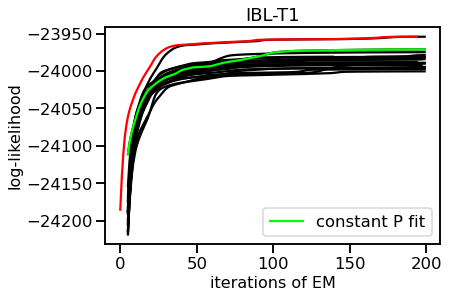

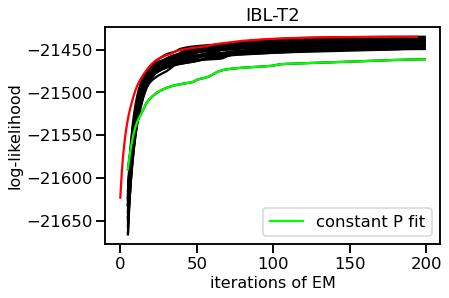

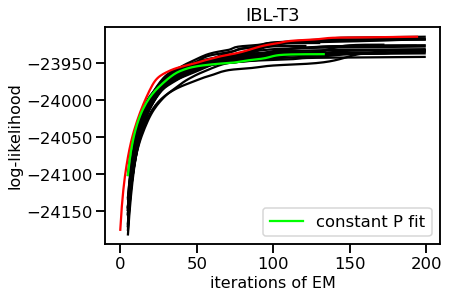

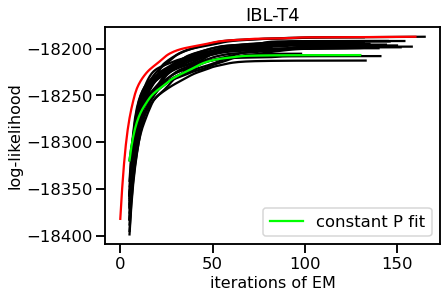

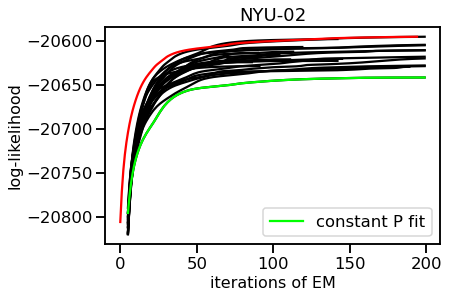

...

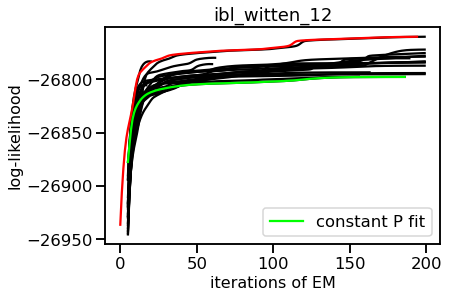

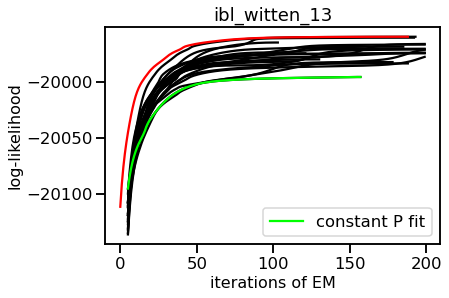

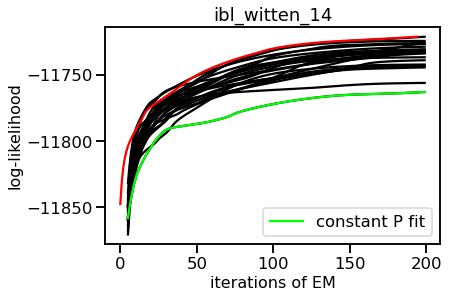

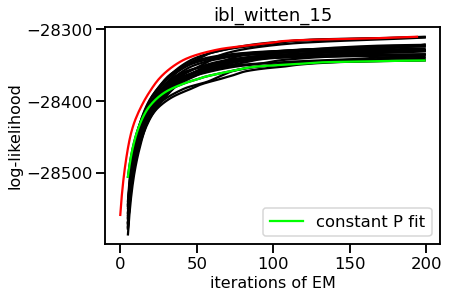

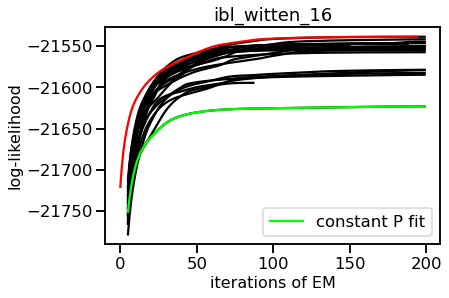

In [7]:
bestInitAll = np.zeros((len(subjectsAll)), dtype=int)
globalInitAll = np.zeros((len(subjectsAll)), dtype=int)
for idx in range(0,len(subjectsAll)):
    subject=subjectsAll[idx]
    param = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}_state_alpha={bestAlpha}_multiple-initsP_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
    trainLl = param['trainLl']
    trainLl[trainLl==0] = np.nan
    fig, axes = plt.subplots(1)
    axes.set_title(subject)
    bestInd, final_lls, bestIndAll = find_top_init_plot_loglikelihoods(trainLl, maxdiff=0.5, ax=axes,startix=5, plot=True)
    bestInitAll[idx] = bestInd
    axes.plot(range(5,maxiter), trainLl[0,5:], color='lime', label='constant P fit')
    axes.legend()
    # print(final_lls[bestInd])
    # print(final_lls[0])



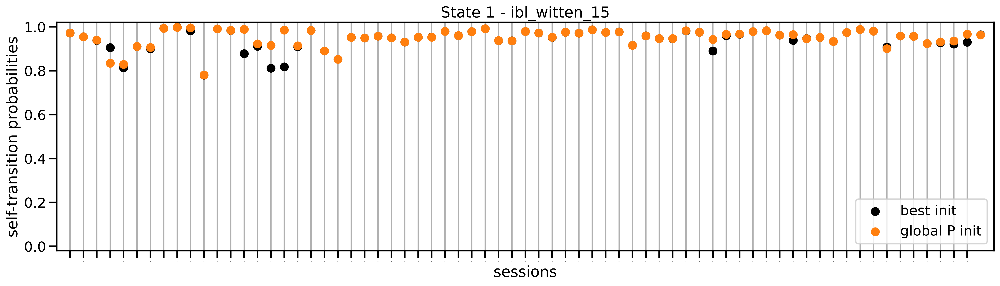

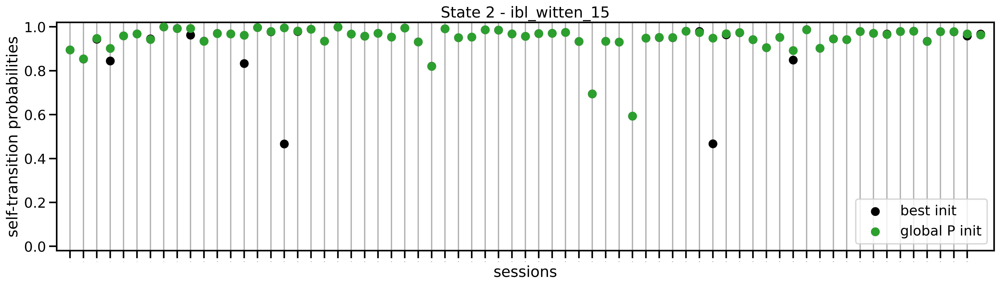

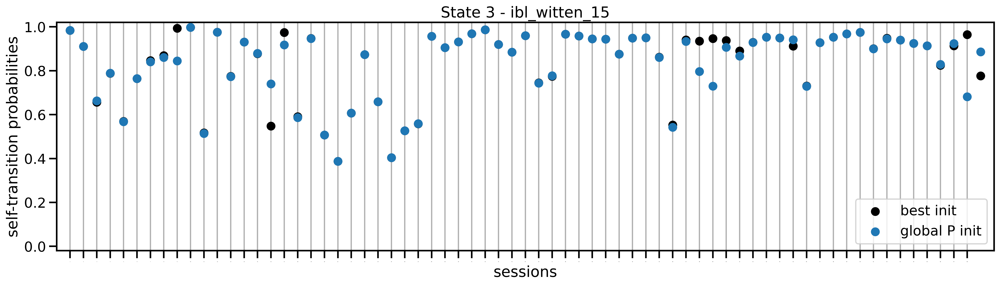

In [61]:
# ibl_witten_07_ALL-PARAM_D=4_3_state_alpha=0_multiple-initsP_L2penaltyW=1_untilSession-1.npz
for idx in [-2]:#range(0,len(subjectsAll)):
    subject=subjectsAll[idx]
    _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
    param = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}_state_alpha={bestAlpha}_multiple-initsP_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
    # bestInd, final_lls, bestIndAll = find_top_init_plot_loglikelihoods(param['trainLl'], maxdiff=1, ax=axes,startix=5, plot=False)
    
    # for ind in bestIndAll:
    #     fig, axes = plt.subplots(1, figsize = (16,6))
    #     plotting_self_transition_probabilities(param['allP'][ind+1], sessInd, axes, trueP=None, title=f'Recovered transition matrix for alpha=0 init={ind+1}', linewidth=2, save_fig=False, sortedStateInd=None)
    sess = len(sessInd)-1
    for i in range(0,K):
        fig, axes = plt.subplots(1, figsize = (20,5), dpi=400)
        axes.set_title(f'State {i+1} - {subject}')
        axes.set_xlim(0,sess+1)
        axes.set_xticks(range(1,sess))
        axes.tick_params(axis='x', labelsize=1)
        axes.grid(axis='x', zorder=0)
        # for ind in bestIndAll:
        #     if ind != bestInd:
        #         axes.scatter(range(1,sess+1),param['allP'][ind][sessInd[:-1],i,i], color='black', label='', zorder=2)
        axes.scatter(range(1,sess+1),param['allP'][bestInitAll[idx]][sessInd[:-1],i,i], color='black', label=f'best init', zorder=3)
        axes.scatter(range(1,sess+1),param['allP'][globalInitAll[idx]][sessInd[:-1],i,i], color=colorsStates[i], label=f'global P init', zorder=3)
        axes.set_xlabel('sessions')
        axes.set_ylabel('self-transition probabilities')
        axes.legend(loc='lower right')
        axes.set_ylim(-0.02,1.02)
    
    # for s in range(0,sess):
    #     print(param['allP'][globalInitAll[idx]][sessInd[s]])    
    # for ind in bestIndAll:
    #     fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
    #     fig.suptitle(f'Init {ind+1}')
    #     fig.tight_layout()
    #     plotting_weights_per_feature(-param['allW'][0], sessInd, axes, yLim=[[-2.5,2.5],[-8.2,8.2], [-1.2,1.2],[-1.2,1.2]], colors=colorsStates, labels=myFeatures[D%2], linewidth=3, linestyle='--', sortedStateInd=None, legend=False)
    #     plotting_weights_per_feature(-param['allW'][ind+1], sessInd, axes, yLim=[[-2.5,2.5],[-8.2,8.2], [-1.2,1.2],[-1.2,1.2]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)
            



/var/folders/w4/p225s7cd19n0j6tss7pdl21w0000gn/T/ipykernel_19614/593942543.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1, figsize = (16,6))


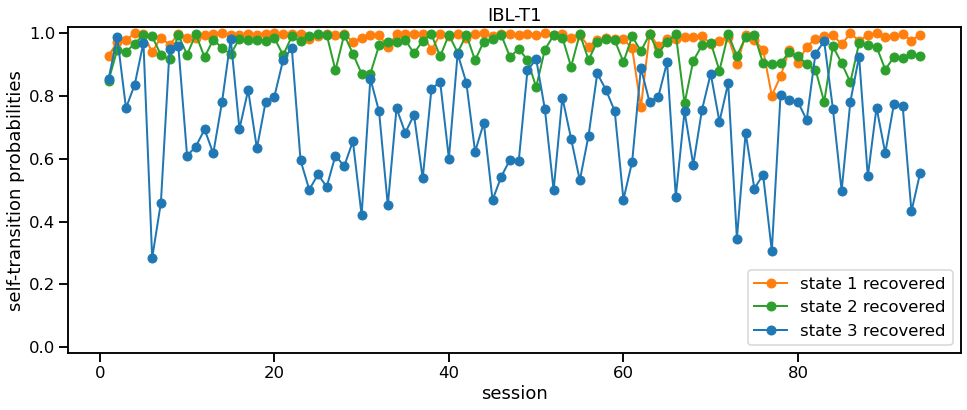

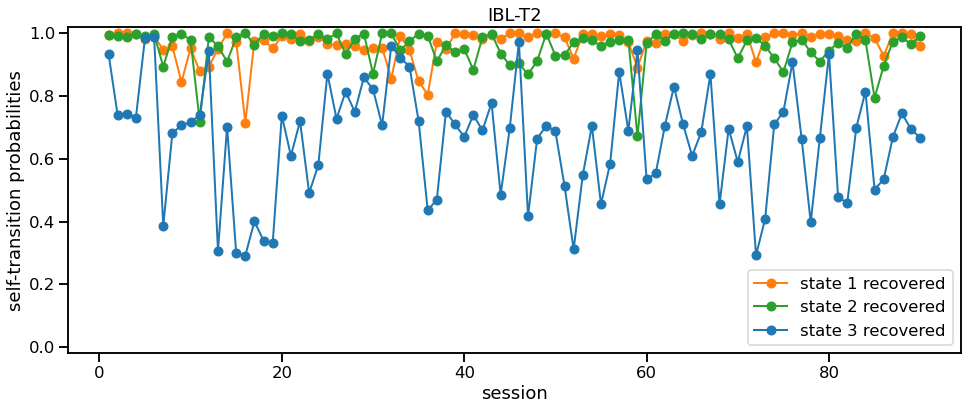

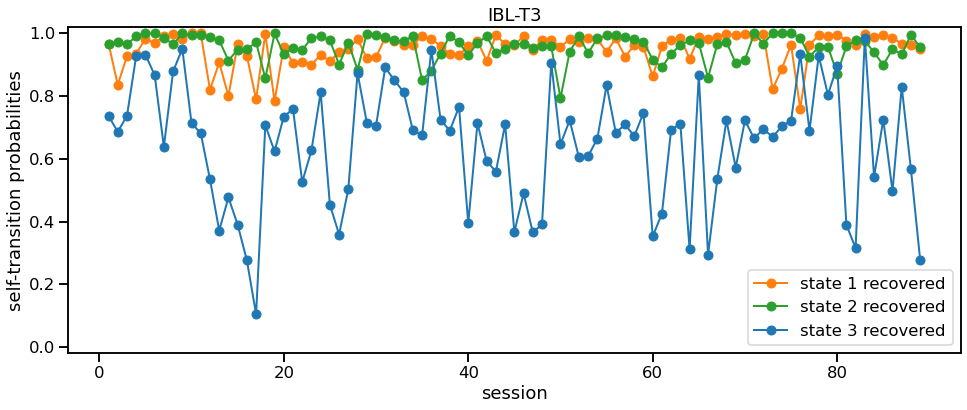

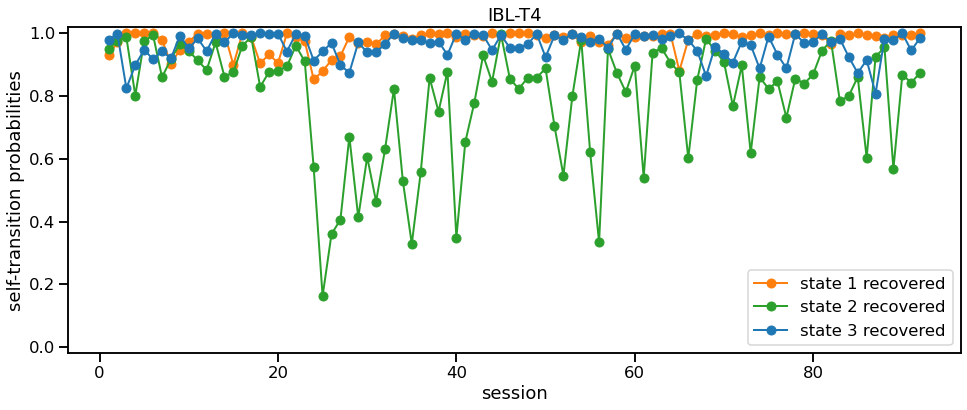

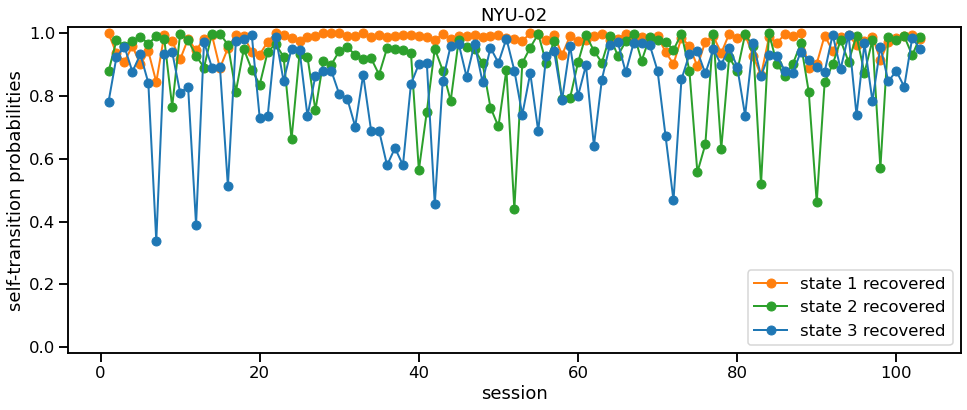

...

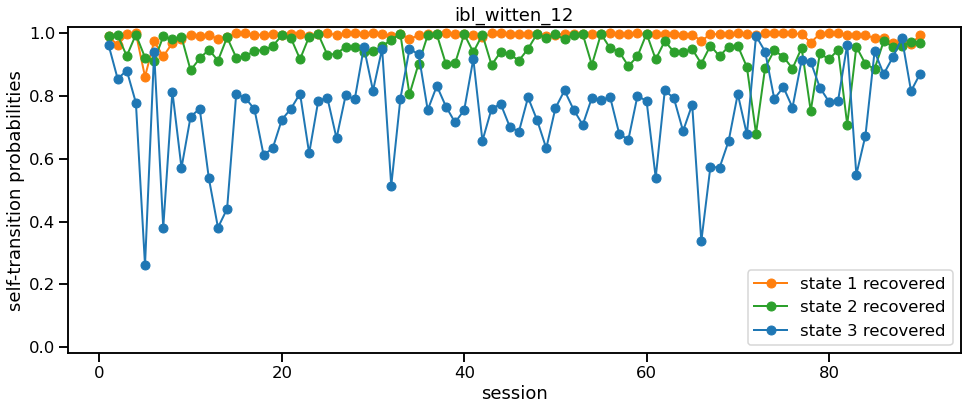

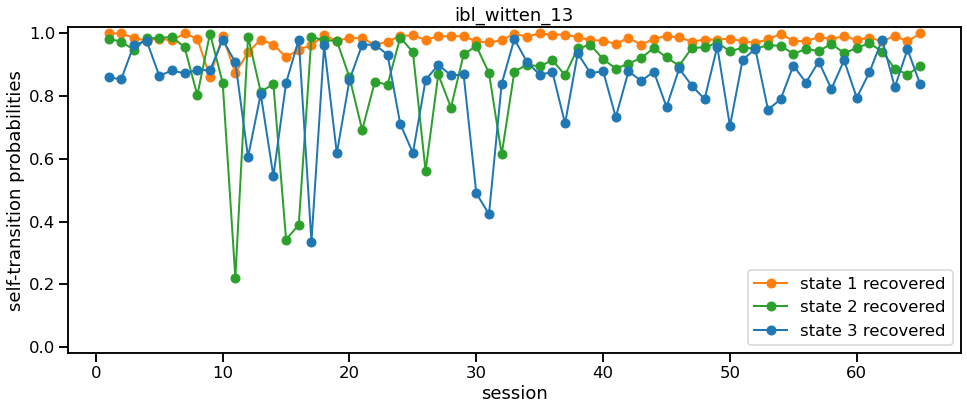

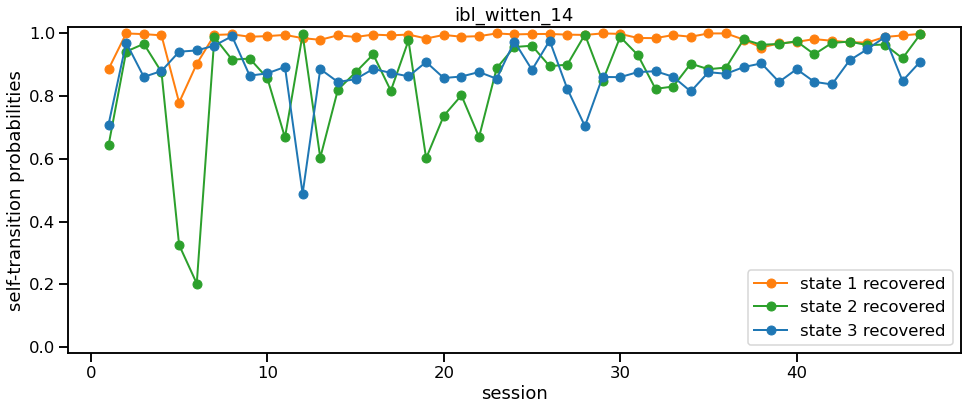

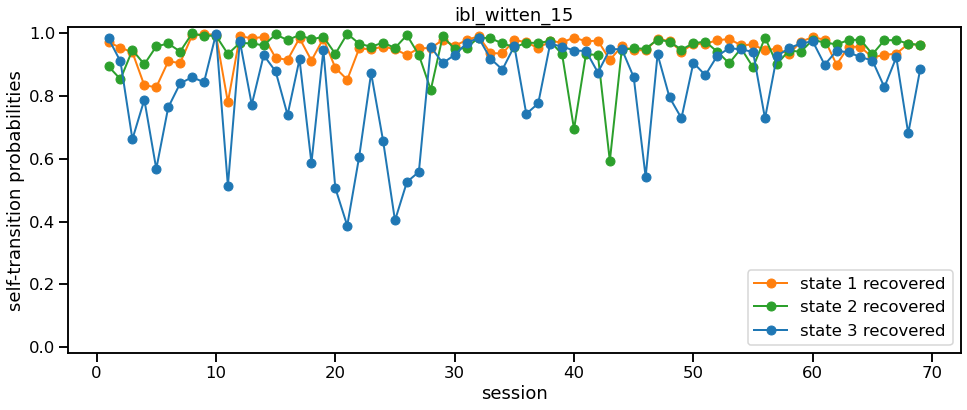

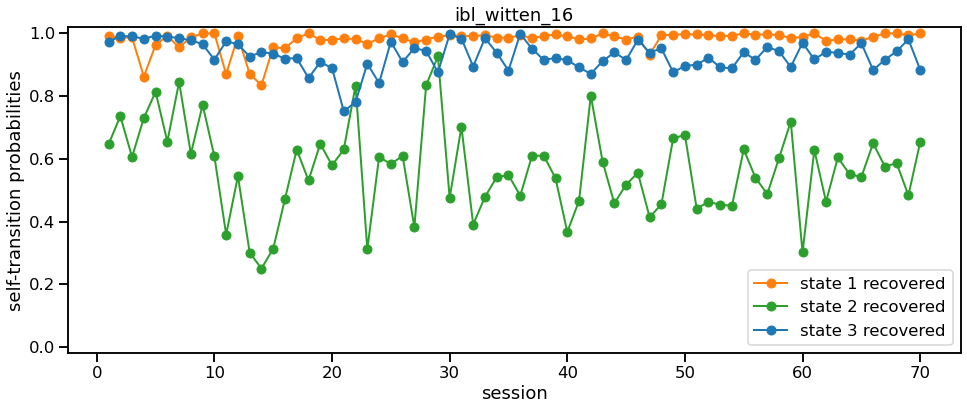

In [62]:
# INIT 0

allW = np.empty((len(subjectsAll)), dtype=object)
allP = np.empty((len(subjectsAll)), dtype=object)
countZeros = np.zeros((len(subjectsAll), 2))
countOnes = np.zeros((len(subjectsAll), 2))

for idx in range(0,len(subjectsAll)):
    subject=subjectsAll[idx]
    _, _, sessInd, correctSide = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
    param = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}_state_alpha={bestAlpha}_multiple-initsP_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
    allP[idx] =  param['allP'][globalInitAll[idx]] # starting from best dGLMHMM1 fit
    allW[idx] =  param['allW'][globalInitAll[idx]] # starting from best dGLMHMM1 fit
    
    fig, axes = plt.subplots(1, figsize = (16,6))
    plotting_self_transition_probabilities(param['allP'][globalInitAll[idx]], sessInd, axes, trueP=None, title=subject, linewidth=2, save_fig=False, sortedStateInd=None, colorsStates=colorsStates)
    axes.set_ylim(-0.02,1.02)

    countZeros[idx, 0] =  (param['allP'][globalInitAll[idx]][sessInd[:-1]] < 0.001).sum()/9/(len(sessInd)-1)*100 # init 0 
    countZeros[idx, 1] = (param['allP'][globalInitAll[idx]][sessInd[:-1]] < 0.0001).sum()/9/(len(sessInd)-1)*100
    countOnes[idx, 0] = (param['allP'][globalInitAll[idx]][sessInd[:-1]] > 0.999).sum()/9/(len(sessInd)-1)*100

    # fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
    # fig.suptitle(subject)
    # fig.tight_layout()
    # plotting_weights_per_feature(-param['allW'][globalInitAll[idx]], sessInd, axes, yLim=[[-2.5,2.5],[-0.2,8.2], [-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)
       

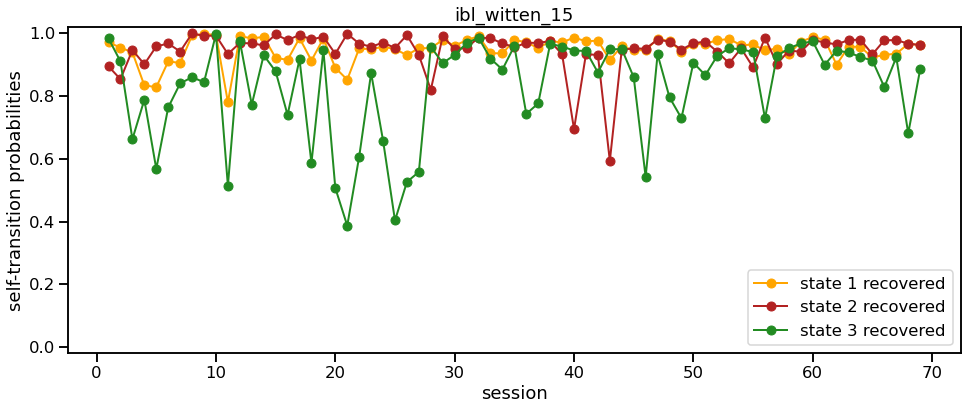

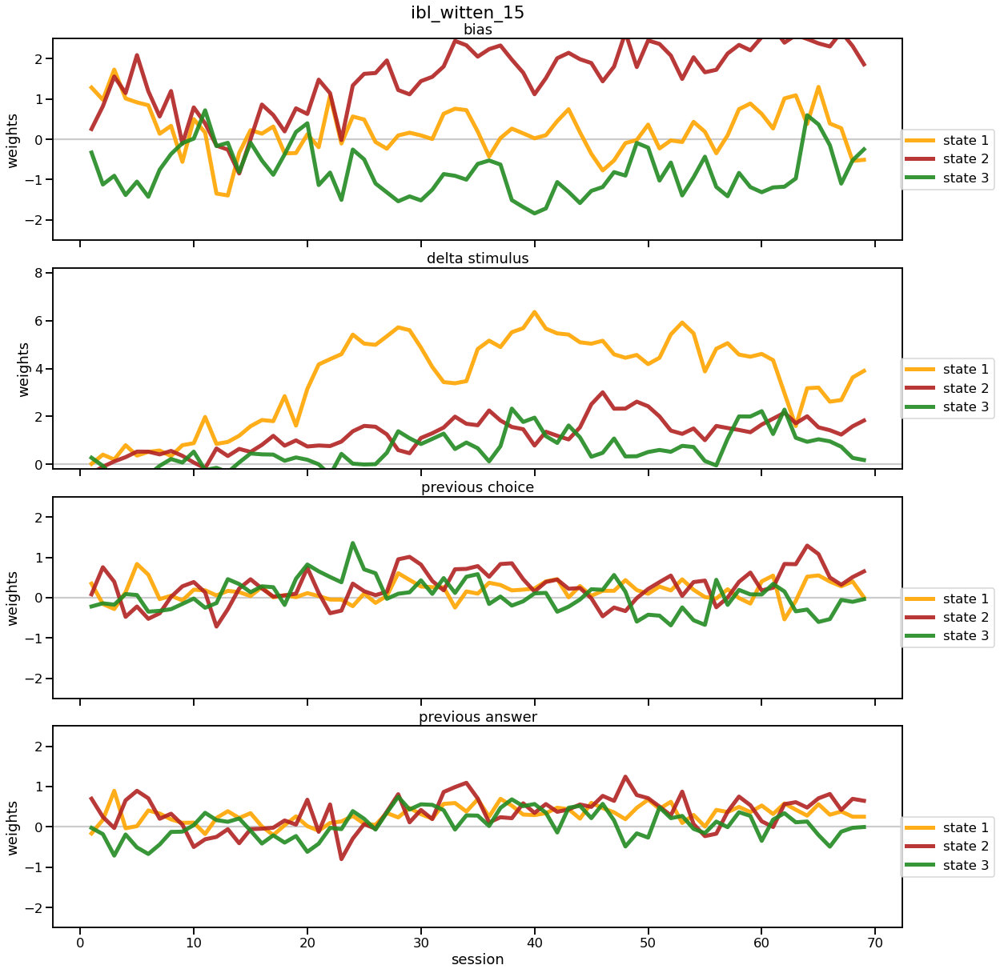

In [28]:
subject='ibl_witten_15'
_, _, sessInd, correctSide = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
param = np.load(f'../data_IBL/{subject}/{subject}_ALL-PARAM_D={D}_{K}_state_alpha={bestAlpha}_multiple-initsP_L2penaltyW={L2penaltyW}_untilSession{sessStop}.npz')
allP[idx] =  param['allP'][globalInitAll[idx]] # starting from best dGLMHMM1 fit
allW[idx] =  param['allW'][globalInitAll[idx]] # starting from best dGLMHMM1 fit
    
fig, axes = plt.subplots(1, figsize = (16,6))
plotting_self_transition_probabilities(param['allP'][globalInitAll[idx]], sessInd, axes, trueP=None, title=subject, linewidth=2, save_fig=False, sortedStateInd=None, colorsStates=colorsStates)
axes.set_ylim(-0.02,1.02)

fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
fig.suptitle(subject)
fig.tight_layout()
plotting_weights_per_feature(-param['allW'][globalInitAll[idx]], sessInd, axes, yLim=[[-2.5,2.5],[-0.2,8.2], [-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)
plotting_weights_per_feature(-param['allW'][globalInitAll[idx]], sessInd, axes, yLim=[[-2.5,2.5],[-0.2,8.2], [-2.5,2.5],[-2.5,2.5]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', sortedStateInd=None)
   

In [15]:
print(countZeros[:, 0].sum(axis=0)/len(subjectsAll))
print(countZeros[:, 1].sum(axis=0)/len(subjectsAll))
print(countOnes[:, 0].sum(axis=0)/len(subjectsAll)*3)

16.54332453621121
6.4934012012639375
4.813445919107707


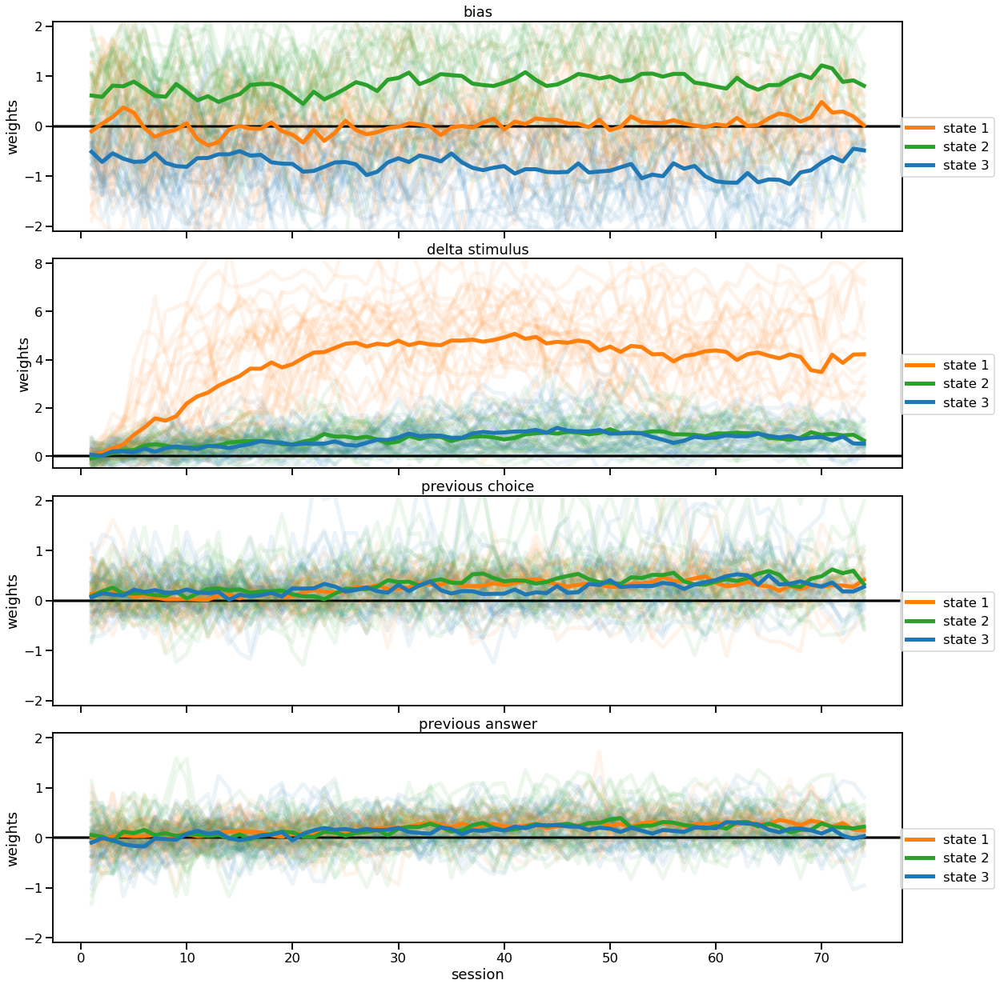

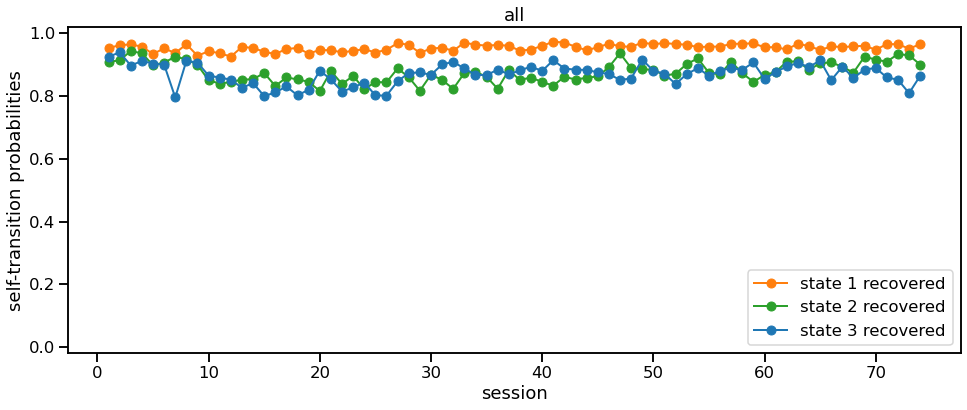

In [46]:
# Plotting weights and transition matrix averaged across all animals - first 70 sessions
maxSess = 75
Kplot = [3]
bestSigmaInd = 7
for K in Kplot:
    arrW = np.ma.empty((maxSess, K, D, 2, len(subjectsAll)))
    arrW.mask = True

    arrP = np.ma.empty((maxSess, K, K, len(subjectsAll)))
    arrP.mask = True

    fig, axes = plt.subplots(D, 1,figsize=(16,4*D+1), sharex=True)
    fig.tight_layout()

    avgP = []
    avgW = []
    for idx in range(0,len(subjectsAll)):
        subject = subjectsAll[idx] 
        _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)

        avgW.append(allW[idx][sessInd[:-1]]) 
        avgP.append(allP[idx][sessInd[:-1]])
        stop = min(avgW[idx].shape[0], maxSess)
        arrW[:stop, :K, :D, :2, idx] = avgW[idx][:stop]
        arrP[:stop, :K, :K, idx] = avgP[idx][:stop]
        plotting_weights_per_feature(-avgW[idx][:stop], [x for x in range (0, stop)], axes, yLim=[[-2.1,2.1],[-0.5,8.2],[-2.1,2.1],[-2.1,2.1]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', alpha=0.08, legend=False, sortedStateInd=None)
        
    plotting_weights_per_feature(-arrW.mean(axis=4), [x for x in range (0, maxSess)], axes, yLim=[[-2.1,2.1],[-0.5,8.2],[-2.1,2.1],[-2.1,2.1]], colors=colorsStates, labels=myFeatures[D%2], linewidth=5, linestyle='-', alpha=1, legend=True, sortedStateInd=None)

    fig, axes = plt.subplots(1, figsize = (16,6))
    plotting_self_transition_probabilities(arrP.mean(axis=3), range(0,maxSess), axes, trueP=None, title='all', linewidth=2, save_fig=False, sortedStateInd=None, colorsStates=colorsStates)
    axes.set_ylim(-0.02,1.02)

    # # plotting transition matrix averaged across folds
    # fig, axes = plt.subplots()
    # plot_transition_matrix(np.mean(avgP, axis=0), title='Averaged', sortedStateInd=None) # not sorted
          

In [7]:
# Computing posterior latents across animals
allGamma = np.empty((len(subjectsAll)), dtype=object)
K = 3
truepi = np.ones((K))
for idx in range(0,len(subjectsAll)):
    subject=subjectsAll[idx]
    x, y, sessInd, correctSide = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
    N = sessInd[-1]
    presentAll = np.ones((N))
    dGLM_HMM = dglm_hmm2.dGLM_HMM2(N,K,D,2)
    allGamma[idx] = dGLM_HMM.get_posterior_latent(allP[idx], truepi, allW[idx], x, y, presentAll, sessInd, sortedStateInd=None)


/Volumes/Lenca_SSD/github/Pillow_dGLM-HMM/code/plotting_utils.py:357: RuntimeWarning: Mean of empty slice
  axes.plot(range(1,len(sessInd)), np.nanmean(np.array([blocksStateRight,blocksStateLeft]),axis=0), color='black',label='mean')
/Volumes/Lenca_SSD/github/Pillow_dGLM-HMM/code/plotting_utils.py:357: RuntimeWarning: Mean of empty slice
  axes.plot(range(1,len(sessInd)), np.nanmean(np.array([blocksStateRight,blocksStateLeft]),axis=0), color='black',label='mean')
/Volumes/Lenca_SSD/github/Pillow_dGLM-HMM/code/plotting_utils.py:357: RuntimeWarning: Mean of empty slice
  axes.plot(range(1,len(sessInd)), np.nanmean(np.array([blocksStateRight,blocksStateLeft]),axis=0), color='black',label='mean')
/Volumes/Lenca_SSD/github/Pillow_dGLM-HMM/code/plotting_utils.py:357: RuntimeWarning: Mean of empty slice
  axes.plot(range(1,len(sessInd)), np.nanmean(np.array([blocksStateRight,blocksStateLeft]),axis=0), color='black',label='mean')
/Volumes/Lenca_SSD/github/Pillow_dGLM-HMM/code/plotting_utils.py

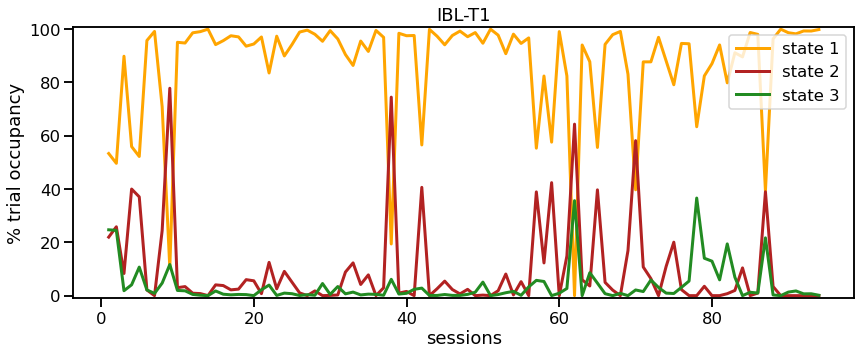

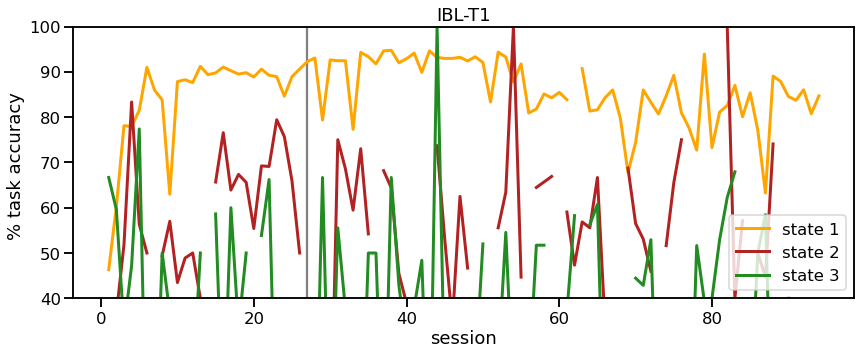

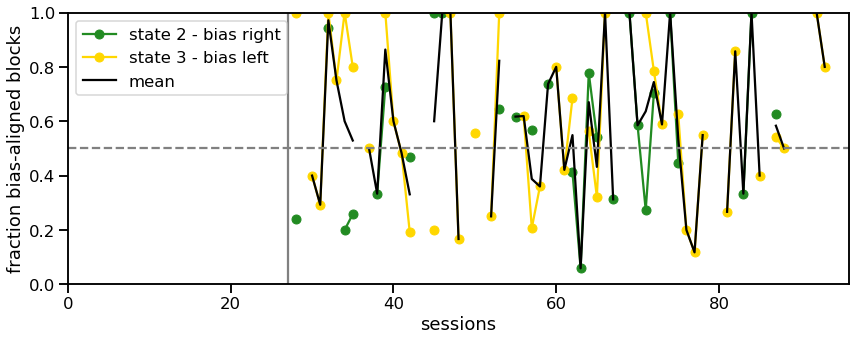

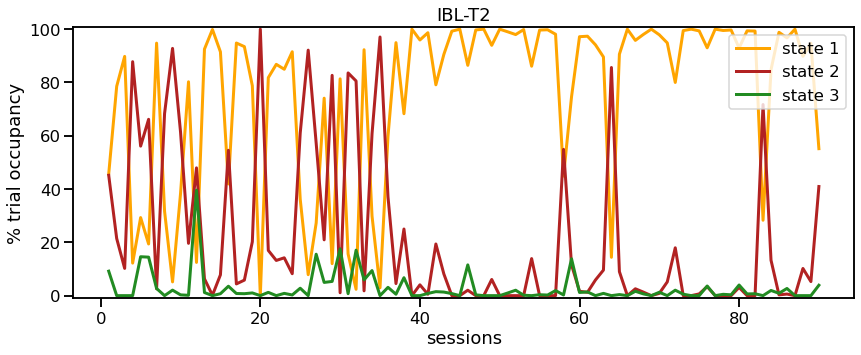

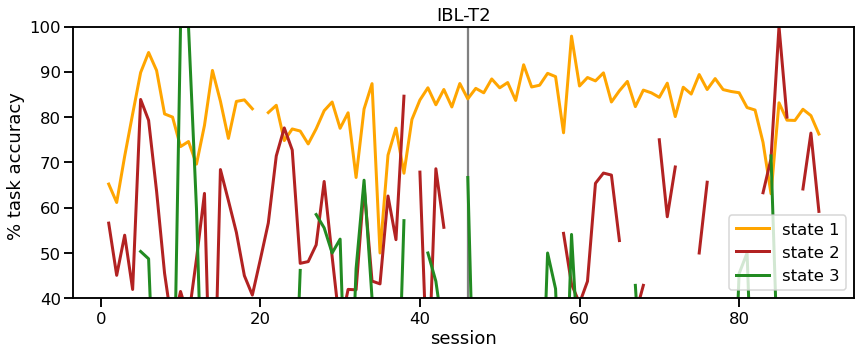

...

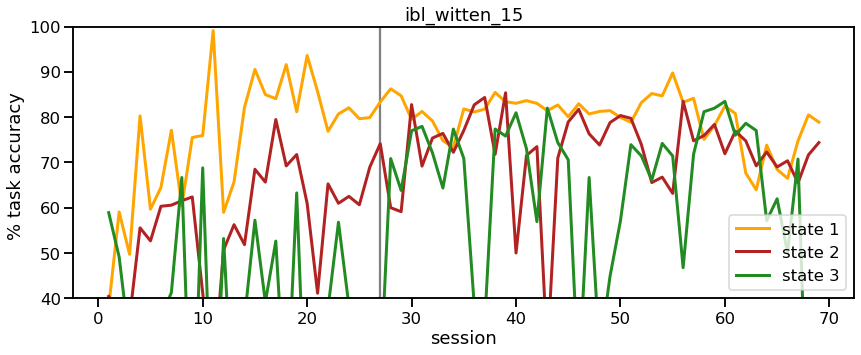

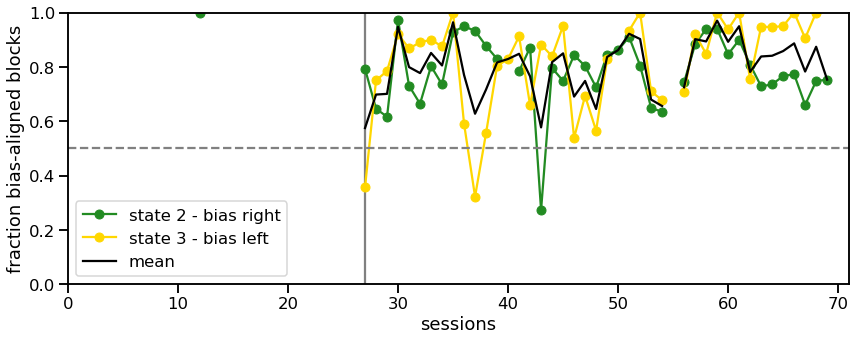

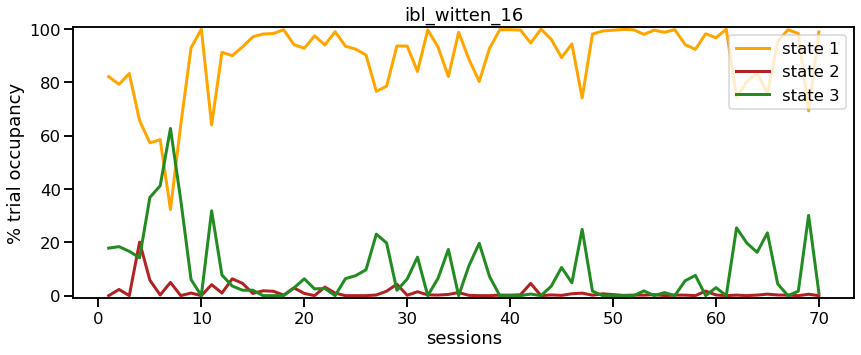

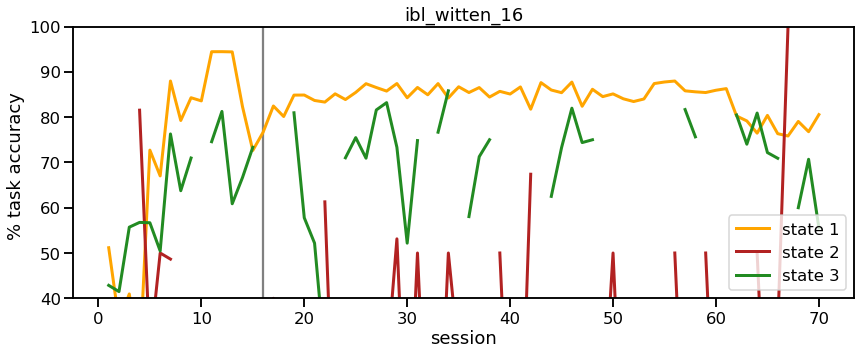

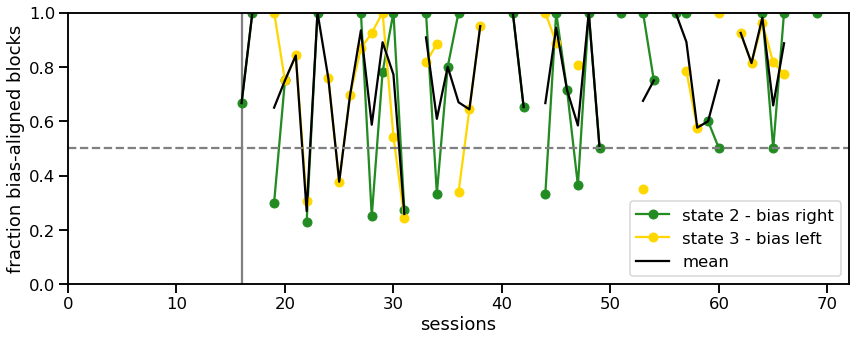

In [37]:
K = 3
allStateCount = np.empty((len(subjectsAll)), dtype=object)
allStateCorrect = np.empty((len(subjectsAll)), dtype=object)
blocksStateRight = np.empty((len(subjectsAll)), dtype=object)
blocksStateLeft = np.empty((len(subjectsAll)), dtype=object)

for idx in range(0,len(subjectsAll)):
    subject = subjectsAll[idx]
    x, y, sessInd, correctSide = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
    biasedBlockTrials, biasedBlockStartInd, biasedBlockSession, firstBlockSession = get_design_biased_blocks(dfAll, subject, sessInd, sessStop)

    # Plotting task occupancy of each state across sessions
    fig, axes = plt.subplots(1, figsize = (14,5))#, dpi=400)
    axes.set_title(subject)
    allStateCount[idx] = plot_state_occupancy_sessions(allGamma[idx], sessInd, axes, colors=colorsStates)
    axes.set_ylim(-1,101)

    # plotting task accuracy in each state across sessions
    fig, axes = plt.subplots(1, figsize = (14,5))#, dpi=400)
    axes.set_title(subject)
    allStateCorrect[idx] = plot_task_accuracy_states_sessions(allGamma[idx], y, correctSide, sessInd, axes, firstBlockSession=firstBlockSession, colors=colorsStates)
    axes.set_ylim(40,100)

    # Plotting alignment of biased states with biased blocks
    fig, axes = plt.subplots(1, figsize=(14,5))
    blocksStateRight[idx], blocksStateLeft[idx] = plot_aligned_fraction_blocks_state(allGamma[idx], sessInd, biasedBlockTrials, biasedBlockSession, axes)

    axes.axvline(firstBlockSession+1, color='gray', zorder=0)

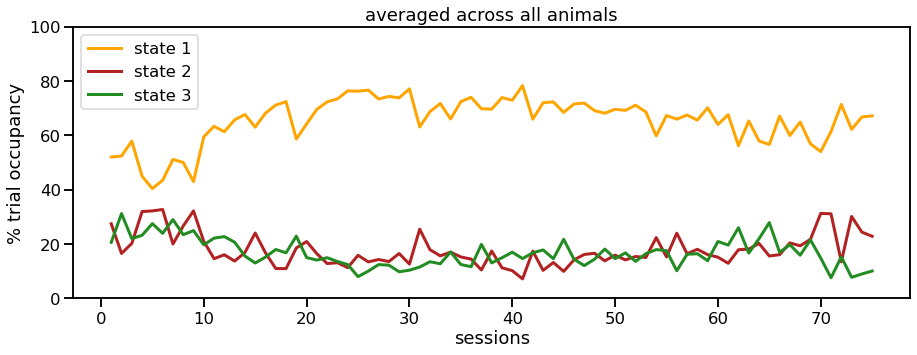

In [38]:
# Plotting weights and transition matrix averaged across all animals - first 70 sessions
maxSess = 75
bestSigmaInd = 7
K = 3

arrStateCount = np.ma.empty((maxSess,K,len(subjectsAll)))
arrStateCount.mask = True

fig, axes = plt.subplots(1, figsize = (15,5))#, dpi=400)
axes.set_title('averaged across all animals')
for idx in range(0,len(subjectsAll)):
    subject = subjectsAll[idx] 
    _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)

    stop = min(len(sessInd)-1, maxSess)
    arrStateCount[:stop, :K, idx] = allStateCount[idx][:stop]
   
for k in range(0,K):
    axes.plot(range(1,maxSess+1), np.nanmean(arrStateCount[:,k,:], axis=1), color=colorsStates[k], linewidth=3, label=f'state {k+1}')
axes.set_ylabel('% trial occupancy')
axes.set_xlabel('sessions')
axes.set_ylim(0,100)
axes.legend(loc='upper left')


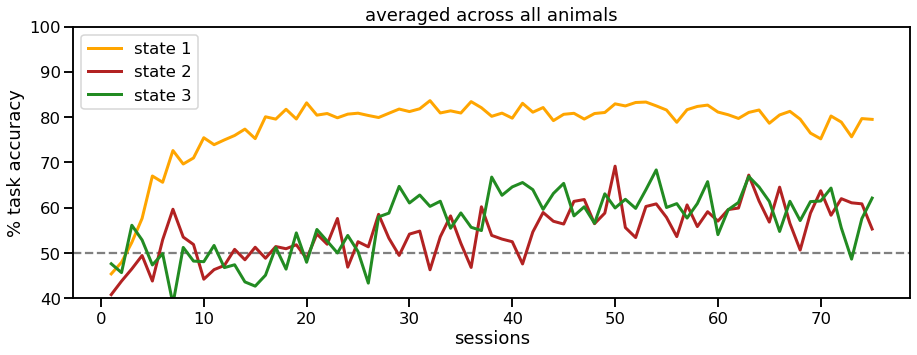

In [39]:
# Plotting weights and transition matrix averaged across all animals - first 70 sessions
maxSess = 75
bestSigmaInd = 7
K = 3

arrStateCorrect = np.ma.empty((maxSess,K,len(subjectsAll)))
arrStateCorrect.mask = True

fig, axes = plt.subplots(1, figsize = (15,5))#, dpi=400)
axes.axhline(50,color='gray',linestyle='dashed')
axes.set_title('averaged across all animals')
for idx in range(0,len(subjectsAll)):
    subject = subjectsAll[idx] 
    _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)

    stop = min(len(sessInd)-1, maxSess)
    arrStateCorrect[:stop, :K, idx] = allStateCorrect[idx][:stop]
   
for k in range(0,K):
    axes.plot(range(1,maxSess+1), np.nanmean(arrStateCorrect[:,k,:], axis=1), color=colorsStates[k], linewidth=3, label=f'state {k+1}')
axes.set_ylabel('% task accuracy')
axes.set_xlabel('sessions')
axes.set_ylim(40,100)
axes.legend(loc='upper left')

Text(0, 0.5, 'biased block sessions')

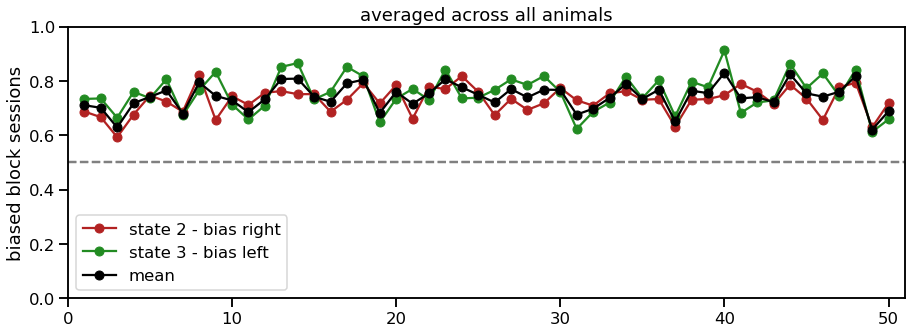

In [42]:
# Average across animals of bias-block alignment with first biased session aligned across animals

# Plotting weights and transition matrix averaged across all animals - first 70 sessions
maxSess = 50
bestSigmaInd = 7
K = 3

arrAlignRight = np.ma.empty((maxSess,len(subjectsAll)))
arrAlignRight.mask = True

arrAlignLeft = np.ma.empty((maxSess,len(subjectsAll)))
arrAlignLeft.mask = True

fig, axes = plt.subplots(1, figsize = (15,5))#, dpi=400)
axes.axhline(0.5,color='gray',linestyle='dashed')
axes.set_title('averaged across all animals')
for idx in range(0,len(subjectsAll)):
    subject = subjectsAll[idx] 
    _, _, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D)
    _, _, _, firstBlockSession = get_design_biased_blocks(dfAll, subject, sessInd, sessStop)
    if (np.isnan(firstBlockSession) == False):
        stop = min(len(sessInd)-1, firstBlockSession+maxSess)
        arrAlignRight[:stop-firstBlockSession, idx] = blocksStateRight[idx][firstBlockSession:stop]
        arrAlignLeft[:stop-firstBlockSession, idx] = blocksStateLeft[idx][firstBlockSession:stop]
        
axes.plot(range(1,maxSess+1), np.nanmean(arrAlignRight[:,:], axis=1), '-o', color='firebrick', label='state 2 - bias right', alpha=1)
axes.plot(range(1,maxSess+1), np.nanmean(arrAlignLeft[:,:], axis=1), '-o', color='forestgreen', label='state 3 - bias left', alpha=1)
axes.plot(range(1,maxSess+1), (np.nanmean(arrAlignRight[:,:], axis=1)+np.nanmean(arrAlignLeft[:,:], axis=1))/2, '-o', color='black',label='mean')
axes.legend()
axes.set_xlim(0,maxSess+1)
axes.axhline(0.5,color='gray',linestyle='dashed')
axes.set_ylim(0,1)
axes.set_ylabel('biased block sessions')


ibl_witten_15


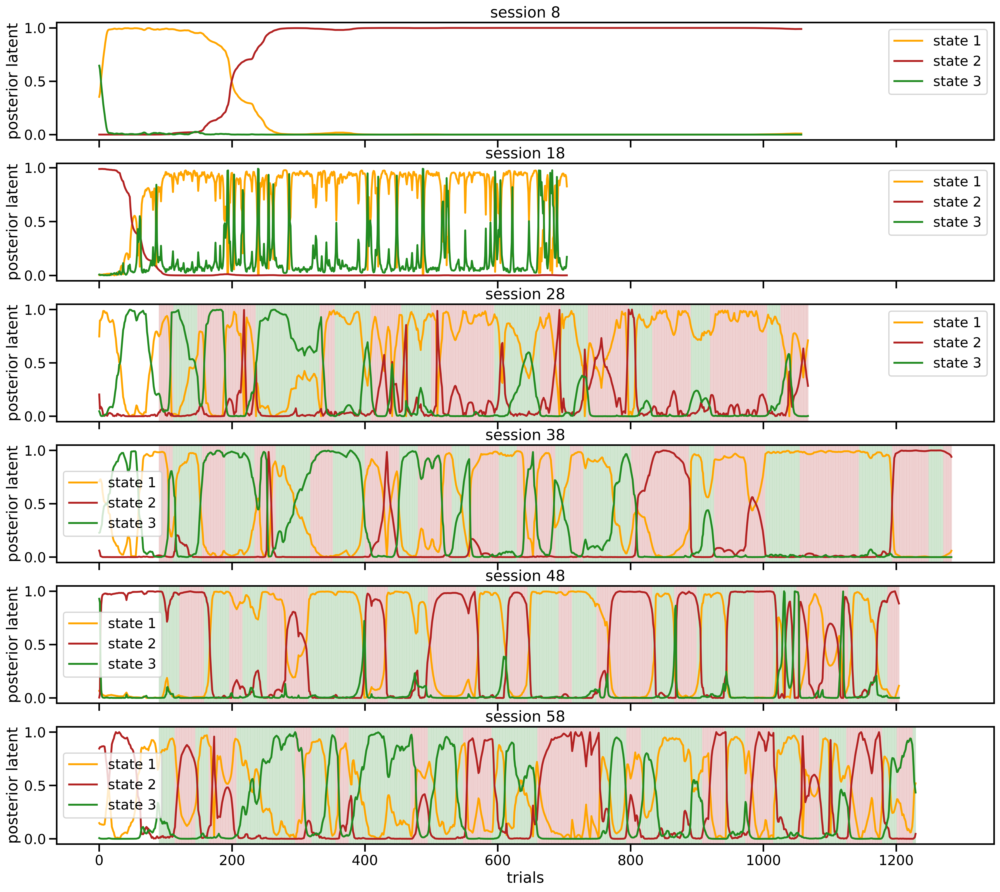

In [8]:
# Plotting Posterior Latents for example sessions
K = 3
bestSigmaInd = 7
sessionsInterest = [7,17,27,37,47,57]
for idx in [-2]:#range(0, len(subjectsWitten)):
    subject = subjectsAll[idx]
    print(subject)
    x, y, sessInd, _ = get_mouse_design(dfAll, subject, sessStop=sessStop, D=D) # NOT LOOKING AT FULL DATASET
    biasedBlockTrials, biasedBlockStartInd, biasedBlockSession, firstBlockSession = get_design_biased_blocks(dfAll, subject, sessInd, sessStop)
    N = x.shape[0]
    
    fig, axes = plt.subplots(len(sessionsInterest), 1, figsize=(20,3*len(sessionsInterest)), dpi=400, sharex=True)
    plot_posteior_latent(allGamma[idx], sessInd, axes, sessions = sessionsInterest)
    for s in range(0,len(sessionsInterest)):
        sess = sessionsInterest[s]
        for t in range(sessInd[sess],sessInd[sess+1]):
            if (biasedBlockTrials[t] == 1):
                axes[s].axvline(t-sessInd[sess], color='firebrick', label='right block', zorder=0, alpha=0.2, linewidth=0.85)
            elif (biasedBlockTrials[t] == -1):
                axes[s].axvline(t-sessInd[sess], color='forestgreen', label='left block', zorder=0, alpha=0.2, linewidth=0.85)


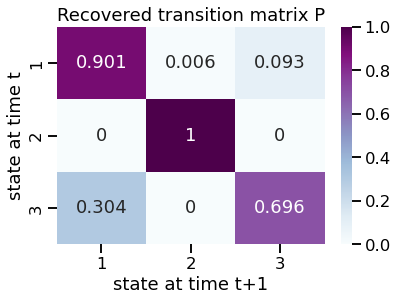

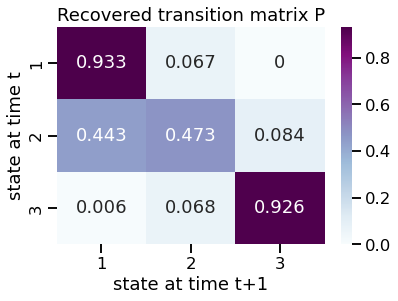

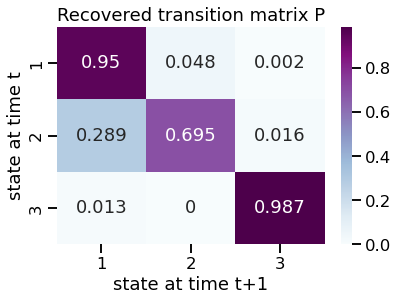

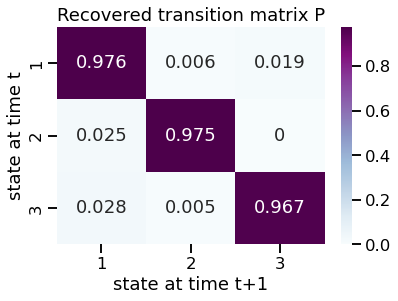

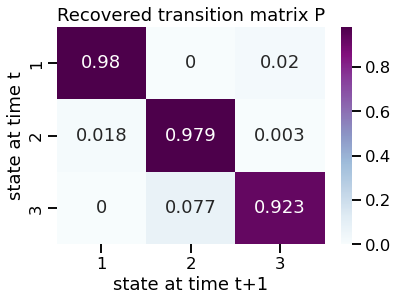

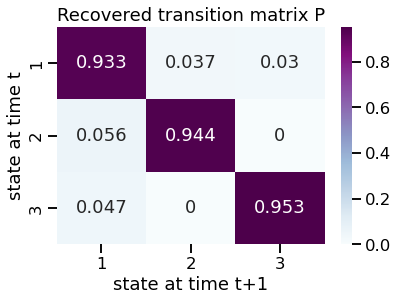

In [25]:
for sess in sessionsInterest:
    fig, axes = plt.subplots()
    plot_transition_matrix(allP[idx][sessInd[sess]])
